이 파일에서는 Ray Tracing 부분을 진행합니다.

In [1]:
# 이 블록은 원본에는 존재하지 않는 부분입니다.

import sys
import os

# 경로 추가
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '../..')))

In [2]:
import os

gpu_num = ""  # Use "" to use the CPU
os.environ["CUDA_VISIBLE_DEVICES"] = f"{gpu_num}"
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"

# Colab does currently not support the latest version of ipython.
# Thus, the preview does not work in Colab. However, whenever possible we
# strongly recommend to use the scene preview mode.
try:  # detect if the notebook runs in Colab
    import google.colab

    colab_compat = True  # deactivate preview
except:
    colab_compat = False

# Allows to exit cell execution in Jupyter
class ExitCell(Exception):
    def _render_traceback_(self):
        pass

import mitsuba as mi
mi.set_variant("llvm_ad_rgb")

# Import Sionna
try:
    import sionna
except ImportError as e:
    # Install Sionna if package is not already installed
    import os

    os.system("pip install sionna")
    import sionna

# Configure the notebook to use only a single GPU and allocate only as much memory as needed
# For more details, see https://www.tensorflow.org/guide/gpu
import tensorflow as tf

gpus = tf.config.list_physical_devices("GPU")
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)
# Avoid warnings from TensorFlow
tf.get_logger().setLevel("ERROR")

tf.random.set_seed(
    1
)  # Set global random seed for reproducibility

In [3]:
# Import Sionna RT components
import geopandas as gpd
import numpy as np
import numpy.typing
from sionna.rt import load_scene, Transmitter, Receiver, PlanarArray, Camera

from src.classes.BostonTwin import BostonTwin
from pathlib import Path

import geopandas as gpd
import numpy as np
import numpy.typing


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# BostonTwin

BostonTwin is a dataset that merges a high-fidelity 3D model of the city of Boston, MA, with the existing geospatial data on cellular base stations deployments, in a ray-tracing-ready format. Thus, BostonTwin enables not only the instantaneous rendering and programmatic access to the building models, but it also allows for an accurate representation of the electromagnetic propagation environment in the real-world city of Boston.

## Quickstart

### Initialize and visualize BostonTwin

Create the BostonTwin object by specifying the path of the dataset. The dataset can be downloaded from <http://hdl.handle.net/2047/D20623157>.

In [4]:
# 이 블록은 원본에는 존재하지 않는 부분입니다.

dataset_dir = Path("../../bostontwin/bostontwin")
dataset_dir

PosixPath('../../bostontwin/bostontwin')

In [5]:
# 이 블록은 원본과 다른 변경된 부분입니다.

# dataset_dir = Path("bostontwin")
bostwin = BostonTwin(dataset_dir)

31 scenes imported.


We can get a list of currently available scenes through the `get_scene_names` method.

In [6]:
scene_names = bostwin.get_scene_names()

scene_names.sort()

print(f"There are {len(scene_names)} scenes available in {dataset_dir}.\n{scene_names}")

There are 31 scenes available in ../../bostontwin/bostontwin.
['BOS_F_4', 'BOS_F_5', 'BOS_F_6', 'BOS_F_7', 'BOS_F_8', 'BOS_F_9', 'BOS_G_3', 'BOS_G_4', 'BOS_G_5', 'BOS_G_6', 'BOS_G_7', 'BOS_G_8', 'BOS_G_9', 'BOS_H_3', 'BOS_H_4', 'BOS_H_5', 'BOS_H_6', 'BOS_H_7', 'BOS_H_8', 'BOS_H_9', 'BOS_I_3', 'BOS_I_4', 'BOS_I_5', 'BOS_I_6', 'BOS_I_7', 'BOS_I_8', 'BOS_I_9', 'BOS_J_3', 'BOS_J_5', 'BOS_J_6', 'BOS_J_7']


Select one scene by specifying its name

In [7]:
scene_name = "BOS_G_5"

and load it

In [8]:
sionna_scene, scene_antennas = bostwin.load_bostontwin(scene_name)

The BostonTwin is fully compatible with Sionna. For a given scene, `load_bostontwin` method returns the Sionna scene and the corresponding antennas.

### Ray Tracing

For an in-depth overview of the Sionna Ray Tracer, we refer to the [original documentation](https://nvlabs.github.io/sionna/api/rt.html#ray-tracing). Here, we report a simple example.

In [9]:
# 이 블록은 원본과 다른 변경된 부분입니다.

n_antennas = scene_antennas.shape[0]
# print(f"There are {n_antennas} antennas in the {new_scene_name} scene.")

In [10]:
n_txs = 5  # number of transmitters
n_rxs = 5  # number of receivers

# select the antennas from scene_antennas using their indices 
ant_ids = np.arange(n_antennas)
tx_ids = np.sort(np.random.choice(ant_ids, size=n_txs, replace=False))  # pick n_txs random indices for the transmitters
rx_ids = np.sort(np.random.choice(np.setdiff1d(ant_ids,tx_ids), size=n_txs, replace=False))  # the rest are receivers 
print(f"Transmitter IDs: {tx_ids}\nReceivers IDs:{rx_ids}")

# Configure antenna array for all transmitters
sionna_scene.tx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="tr38901",
                             polarization="V")

# Configure antenna array for all receivers
sionna_scene.rx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="dipole",
                             polarization="cross")

# add the antennas to the BostonTwin
tx_rx_dict = bostwin.add_scene_antennas(tx_ids,rx_ids)

Transmitter IDs: [ 46  62  65 106 147]
Receivers IDs:[25 61 70 73 91]


In [11]:
paths = sionna_scene.compute_paths(
                    max_depth=2,
                    num_samples=1e5,
                    reflection=True,
                    diffraction=True,
                    scattering=True,
                   )

In [12]:
sionna_scene.preview(paths, show_devices=True, show_paths=True)

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, position=(0.0, 0.0, …

In [14]:
# 이 블록은 원본에는 존재하지 않는 부분입니다.
render_cam = Camera("render_cam",position=[-300, -500, 150])
sionna_scene.add(render_cam)
render_cam.look_at([500, 700, 0])

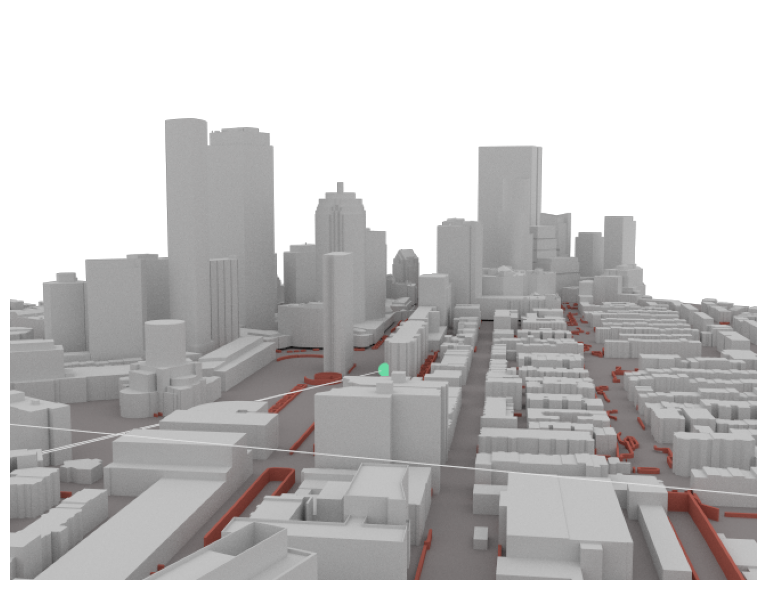

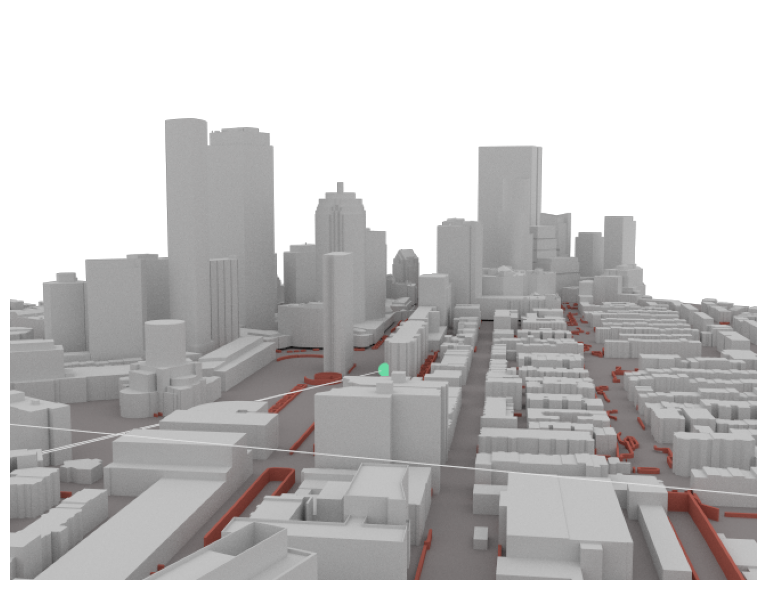

In [15]:
sionna_scene.render(render_cam, paths=paths, show_devices=True, show_paths=True)

In [16]:
cm = sionna_scene.coverage_map(max_depth=2,
                        diffraction=True, # Disable to see the effects of diffraction
                        cm_cell_size=(5., 5.), # Grid size of coverage map cells in m
                        combining_vec=None,
                        precoding_vec=None,
                        num_samples=int(1e5))

In [17]:
[sionna_scene.get(tx).position for tx in sionna_scene.transmitters]

[<tf.Tensor: shape=(3,), dtype=float32, numpy=array([-430.3718,  133.8959,   10.    ], dtype=float32)>,
 <tf.Tensor: shape=(3,), dtype=float32, numpy=array([  6.3379188, 643.41437  ,  10.       ], dtype=float32)>,
 <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-626.85486,  710.3335 ,   10.     ], dtype=float32)>,
 <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-676.86584, -496.8731 ,   10.     ], dtype=float32)>,
 <tf.Tensor: shape=(3,), dtype=float32, numpy=array([-266.3164 ,  168.78848,   10.     ], dtype=float32)>]

In [18]:
sionna_scene.preview(coverage_map=cm, show_devices=True)

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, matrixWorldNeedsUpda…